In [ ]:
import numpy as np
import argparse
import imutils
import sys
import cv2
from google.colab.patches import cv2_imshow

In [ ]:
CLASSES = open("/content/drive/MyDrive/CV/Project2/action_recognition_kinetics.txt").read().strip().split("\n")

In [ ]:
SAMPLE_DURATION = 16
SAMPLE_SIZE = 112

In [ ]:
net = cv2.dnn.readNet("/content/drive/MyDrive/CV/Project2/resnet-34_kinetics.onnx")

In [ ]:
vs = cv2.VideoCapture("/content/drive/MyDrive/CV/Project2/example_activities.mp4")

In [ ]:
from google.colab.patches import cv2_imshow

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


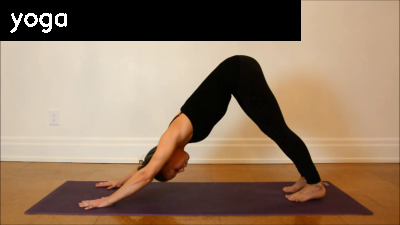

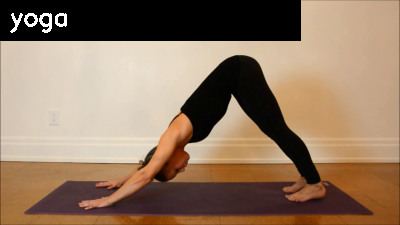

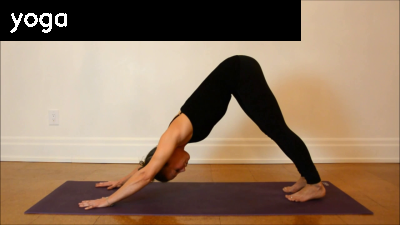

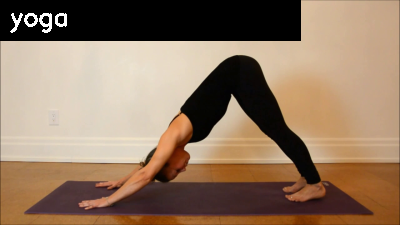

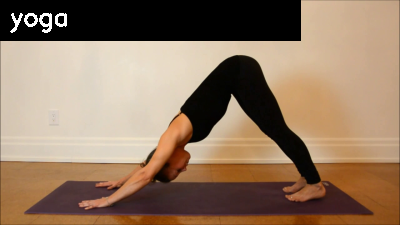

...

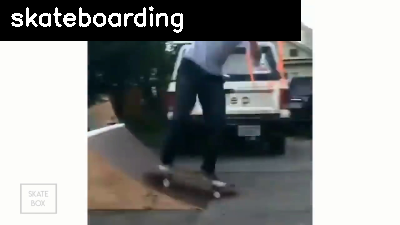

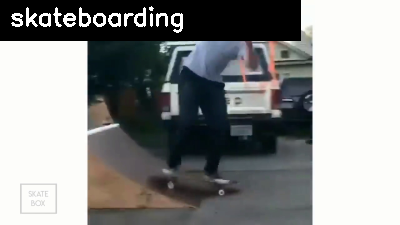

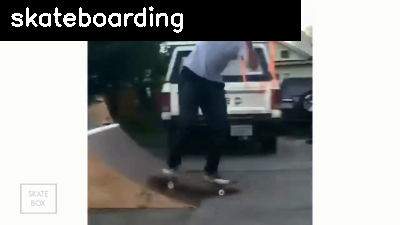

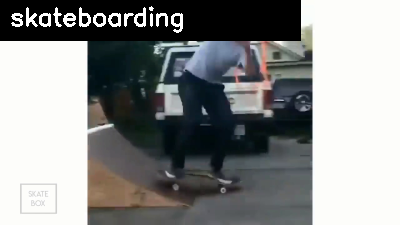

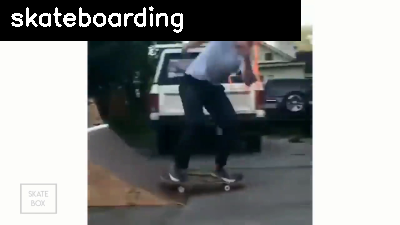

KeyboardInterrupt: ignored

In [ ]:
while True:
	
	frames = []

	
	for i in range(0, SAMPLE_DURATION):
		(grabbed, frame) = vs.read()

		
		if not grabbed:
			print("[INFO] no frame read from stream - exiting")
			sys.exit(0)

		
		frame = imutils.resize(frame, width=400)
		frames.append(frame)

	blob = cv2.dnn.blobFromImages(frames, 1.0,
		(SAMPLE_SIZE, SAMPLE_SIZE), (114.7748, 107.7354, 99.4750),
		swapRB=True, crop=True)
	blob = np.transpose(blob, (1, 0, 2, 3))
	blob = np.expand_dims(blob, axis=0)

	
	net.setInput(blob)
	outputs = net.forward()
	label = CLASSES[np.argmax(outputs)]

	for frame in frames:
		cv2.rectangle(frame, (0, 0), (300, 40), (0, 0, 0), -1)
		cv2.putText(frame, label, (10, 25), cv2.FONT_HERSHEY_SIMPLEX,
			0.8, (255, 255, 255), 2)

		cv2_imshow(frame)
		key = cv2.waitKey(1) & 0xFF

		if key == ord("q"):
			break

In [ ]:
%cd /content/drive/MyDrive/CV/Project2

/content/drive/MyDrive/CV/Project2


In [ ]:
!unrar x UCF101.rar

In [ ]:
%cd /content/drive/MyDrive/CV/Project2/UCF101

/content/drive/MyDrive/CV/Project2/UCF101


In [ ]:
test_file = "/content/drive/MyDrive/CV/Project2/UCF101/testlist.txt"
train_file = "/content/drive/MyDrive/CV/Project2/UCF101/trainlist.txt"

In [ ]:
with open(test_file) as fin:
  test_list = [row.strip() for row in list(fin)]

In [ ]:
with open(train_file) as fin:
  train_list = [row.strip() for row in list(fin)]
  train_list = [row.split(' ')[0] for row in train_list]

In [ ]:
file_groups = {
   'train': train_list,
   'test': test_list
              }

In [ ]:
import os
import os.path

In [ ]:
for group, videos in file_groups.items():

  # Do each of our videos.
  for video in videos:
    # Get the parts.
    parts = video.split(os.path.sep)
    classname = parts[0]
    filename = parts[1]

    # Check if this class exists.
    if not os.path.exists(os.path.join(group, classname)):
      print("Creating folder for %s/%s" % (group, classname))
      os.makedirs(os.path.join(group, classname))

    # Check if we have already moved this file, or at least that it exists to move.
    if not os.path.exists(os.path.join(classname, filename)):
      print("Can't find %s to move. Skipping." % (os.path.join(classname, filename)))
      continue

    # Move it.
    dest = os.path.join(group, classname, filename)
    print("Moving %s to %s" % (os.path.join(classname, filename), dest))
    os.rename(os.path.join(classname, filename), dest)

print("Done.")

In [ ]:
%pwd

'/content/drive/MyDrive/CV/Project2/UCF101'

In [ ]:
%ll

total 8
drwx------ 2 root 4096 May  7 15:27 test/
drwx------ 2 root 4096 May  7 15:26 train/


In [ ]:
%cd /content/drive/MyDrive/CV/Project2/UCF101

/content/drive/MyDrive/CV/Project2/UCF101


In [ ]:
%pwd

'/content/drive/MyDrive/CV/Project2/UCF101'

In [ ]:
import csv
import glob
import os.path
from subprocess import call
import os

In [ ]:
def get_video_parts(video_path):
    parts = video_path.split(os.path.sep)
    filename = parts[2]
    filename_no_ext = filename.split('.')[0]
    classname = parts[1]
    train_or_test = parts[0]

    return train_or_test, classname, filename_no_ext, filename

In [ ]:
def check_already_extracted(video_parts):
    train_or_test, classname, filename_no_ext, _ = video_parts
    return bool(os.path.exists(os.path.join(train_or_test, classname,
                               filename_no_ext + '-0001.jpg')))

In [ ]:
def get_nb_frames_for_video(video_parts):
    train_or_test, classname, filename_no_ext, _ = video_parts
    generated_files = glob.glob(os.path.join(train_or_test, classname,
                                filename_no_ext + '*.jpg'))
    return len(generated_files)

In [ ]:
def extract_files():
    data_file = []
    folders = ['train','test']
    for folder in folders:
        class_folders = glob.glob(os.path.join(folder, '*'))

        for vid_class in class_folders:
            class_files = glob.glob(os.path.join(vid_class, '*.avi'))

            for video_path in class_files:
                # Get the parts of the file.
                video_parts = get_video_parts(video_path)

                train_or_test, classname, filename_no_ext, filename = video_parts

                # Only extract if we haven't done it yet. Otherwise, just get
                # the info.
                if not check_already_extracted(video_parts):
                    # Now extract it.
                    src = os.path.join(train_or_test, classname, filename)
                    dest = os.path.join(train_or_test, classname,
                        filename_no_ext + '-%04d.jpg')
                    call(["ffmpeg", "-i", src, dest])

                # Now get how many frames it is.
                nb_frames = get_nb_frames_for_video(video_parts)

                data_file.append([train_or_test, classname, filename_no_ext, nb_frames])

                #print("Generated %d frames for %s" % (nb_frames, filename_no_ext))

    with open('data_file.csv', 'w') as fout:
        writer = csv.writer(fout)
        writer.writerows(data_file)
    #[train|test], class, filename, nb frames
    print("Extracted and wrote %d video files." % (len(data_file)))

In [ ]:
extract_files()

In [ ]:
import Dataset
import numpy as np
import os.path
from keras.preprocessing import image as Img
from keras.applications.inception_v3 import InceptionV3, preprocess_input
from keras.models import Model, load_model
from keras.layers import Input
from tqdm import tqdm

# Get the dataset.
data = DataSet(seq_length=40, class_limit=70)

base_model = InceptionV3(
    weights='imagenet',
    include_top=True
)
# We'll extract features at the final pool layer.
model = Model(
    inputs=base_model.input,
    outputs=base_model.get_layer('avg_pool').output
)

# Loop through data.
pbar = tqdm(total=len(data.data))
for video in data.data:

    # Get the path to the sequence for this video.
    path = os.path.join('data', 'sequences', video[2] + '-' + str(seq_length) + \
        '-features')  # numpy will auto-append .npy
    # Check if we already have it.
    if os.path.isfile(path + '.npy'):
        pbar.update(1)
        continue

    # Get the frames for this video.
    frames = data.get_frames_for_sample(video)
    #print(frames)

    # Now downsample to just the ones we need.
    frames = data.rescale_list(frames, 40)
    #print(frames)
    #extracting features and appending to build the sequence.
    sequence = []
    for image in frames:
        img = Img.load_img(image, target_size=(299, 299))
        x = Img.img_to_array(img)
        x = np.expand_dims(x, axis=0)
        x = preprocess_input(x)
        features = model.predict(x)
        sequence.append(features[0])

    # Save the sequence.
    np.save(path, sequence)

    pbar.update(1)

pbar.close()

101



100%|██████████| 8380/8380 [00:08<00:00, 994.54it/s] 

In [ ]:
import Dataset
from keras.layers import Dense, Flatten, Dropout, ZeroPadding3D
from keras.layers.recurrent import LSTM
from keras.models import Sequential, load_model
from keras.optimizers import Adam
from collections import deque
import sys
from keras.callbacks import TensorBoard, ModelCheckpoint, EarlyStopping, CSVLogger
import time
import os.path
checkpointer = ModelCheckpoint(
    filepath=os.path.join('data', 'checkpoints','lstm-features' + '.{epoch:03d}-{val_loss:.3f}.hdf5'),
    verbose=1,
    save_best_only=True)

# Helper: TensorBoard
tb = TensorBoard(log_dir=os.path.join('data', 'logs', 'lstm'))

# Helper: Stop when we stop learning.
early_stopper = EarlyStopping(patience=10)

# Helper: Save results.
timestamp = time.time()
csv_logger = CSVLogger(os.path.join('data', 'logs', 'lstm' + '-' + 'training-' + \
    str(timestamp) + '.log'))

# Get the data and process it.
data = DataSet(
    seq_length=40,
    class_limit=70
)
X, y = data.get_all_sequences_in_memory('train', 'features')
X_test, y_test = data.get_all_sequences_in_memory('test', 'features')


model = Sequential()
model.add(LSTM(2048, return_sequences=False,input_shape=(40,2048),dropout=0.5))
model.add(Dense(512, activation='relu'))
model.add(Dropout(0.5))
model.add(Dense(len(data.classes), activation='softmax'))
optimizer = Adam(lr=1e-5, decay=1e-6)
model.compile(loss='categorical_crossentropy', optimizer=optimizer,
                    metrics=['accuracy','top_k_categorical_accuracy'])
print(model.summary())

model.fit(
    X,
    y,
    batch_size=32,
    validation_data=(X_test, y_test),
    verbose=1,
    callbacks=[tb, early_stopper, csv_logger,checkpointer],
    epochs=100)
    

101
Loading 5980 samples into memory for training.
Loading 2400 samples into memory for testing.
Instructions for updating:
Please use `rate` instead of `keep_prob`. Rate should be set to `rate = 1 - keep_prob`.


Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 2048)              33562624  
_________________________________________________________________
dense_1 (Dense)              (None, 512)               1049088   
_________________________________________________________________
dropout_1 (Dropout)          (None, 512)               0         
_________________________________________________________________
dense_2 (Dense)              (None, 70)                35910     
Total params: 34,647,622
Trainable params: 34,647,622
Non-trainable params: 0
_________________________________________________________________
None
Instructions for upda

In [ ]:
from keras.layers import Dense, Flatten, Dropout, ZeroPadding3D
from keras.layers.recurrent import LSTM
from keras.models import Sequential, load_model
from keras.optimizers import Adam
from collections import deque
import sys
import time
import os.path
import glob

model = Sequential()
model.add(LSTM(2048, return_sequences=False,input_shape=(40,2048),dropout=0.5))
model.add(Dense(512, activation='relu'))
model.add(Dropout(0.5))
model.add(Dense(70, activation='softmax'))
model.load_weights('lstm-features.hdf5')
print(model.summary())

classes = glob.glob("UCF101/train/*")
classes = [classes[i].split('/')[2] for i in range(len(classes))]
classes = sorted(classes)

Using TensorFlow backend.






Instructions for updating:
Please use `rate` instead of `keep_prob`. Rate should be set to `rate = 1 - keep_prob`.






Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 2048)              33562624  
_________________________________________________________________
dense_1 (Dense)              (None, 512)               1049088   
_________________________________________________________________
dropout_1 (Dropout)          (None, 512)               0         
_________________________________________________________________
dense_2 (Dense)              (None, 70)                35910     
Total params: 34,647,622
Trainable params: 34,647,622
Non-trainable params: 0
_________________________________________________________________
None


In [ ]:
import glob
import numpy as np
import os.path
from keras.preprocessing import image as Img
from keras.applications.inception_v3 import InceptionV3, preprocess_input
from keras.models import Model, load_model
from keras.layers import Input
from tqdm import tqdm

path= 'UCF101/train/BoxingSpeedBag/'
y = glob.glob(path+'*.avi')
for Z in y: 
  name = (Z.split('/')[2]).split('.')[0]
  name = name+'-40-features.npy'
  X = glob.glob("data/sequences/"+name)
  seq = np.array([[]])
  flag=1
  for i in X:
    tmp = np.load(i)
    if flag==1:
      seq = tmp
    else:
      seq = np.append(seq,tmp,0)
  seq = np.array([seq])
  if(seq.shape != (1,40,2048)):
    continue
  prediction = model.predict(seq)

  maxm = prediction[0][0]
  maxid = 0
  for i in range(len(prediction[0])):
    if(maxm<prediction[0][i]):
      maxm = prediction[0][i]
      maxid = i

  print(Z,' ------- ',classes[maxid])

UCF101/BoxingSpeedBag/v_BoxingSpeedBag_g01_c02.avi  -------  BoxingSpeedBag
UCF101/BoxingSpeedBag/v_BoxingSpeedBag_g01_c03.avi  -------  BoxingSpeedBag
UCF101/BoxingSpeedBag/v_BoxingSpeedBag_g01_c04.avi  -------  BoxingSpeedBag
UCF101/BoxingSpeedBag/v_BoxingSpeedBag_g02_c01.avi  -------  BoxingSpeedBag
UCF101/BoxingSpeedBag/v_BoxingSpeedBag_g02_c02.avi  -------  BoxingSpeedBag
UCF101/BoxingSpeedBag/v_BoxingSpeedBag_g02_c03.avi  -------  BoxingSpeedBag
UCF101/BoxingSpeedBag/v_BoxingSpeedBag_g02_c04.avi  -------  BoxingSpeedBag
UCF101/BoxingSpeedBag/v_BoxingSpeedBag_g03_c01.avi  -------  BoxingSpeedBag
UCF101/BoxingSpeedBag/v_BoxingSpeedBag_g03_c02.avi  -------  BoxingSpeedBag
UCF101/BoxingSpeedBag/v_BoxingSpeedBag_g03_c03.avi  -------  BoxingSpeedBag
UCF101/BoxingSpeedBag/v_BoxingSpeedBag_g03_c04.avi  -------  BoxingSpeedBag
UCF101/BoxingSpeedBag/v_BoxingSpeedBag_g03_c05.avi  -------  BoxingSpeedBag
UCF101/BoxingSpeedBag/v_BoxingSpeedBag_g04_c01.avi  -------  BoxingSpeedBag
UCF101/Boxin